# 🎧 Spotify Music Data Analysis 

# Average Popularity of Music Genres

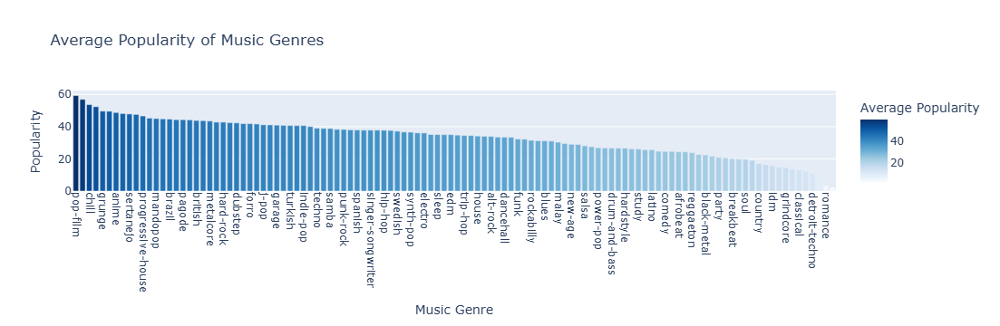

In [3]:
import pandas as pd
import plotly.express as px

dataset_path = r"C:\Users\Z-BLOCK\Downloads\spotify dataset.zip"
df = pd.read_csv(dataset_path)

# Group by genre and calculate average popularity
genre_popularity = df.groupby("track_genre")["popularity"].mean().reset_index()
genre_popularity = genre_popularity.sort_values(by="popularity", ascending=False)

# interactive bar chart
fig = px.bar(
    genre_popularity,
    x='track_genre',
    y='popularity',
    title='Average Popularity of Music Genres',
    labels={'track_genre': 'Genre', 'popularity': 'Average Popularity'},
    color='popularity',
    color_continuous_scale='Blues'
)

fig.update_layout(xaxis_tickangle=90, xaxis_title='Music Genre', yaxis_title='Popularity')

fig.show()

fig.write_html("genre_popularity.html")


# Top 10 Most Popular Artists Based on Average Track Popularity

                           artists  popularity
24119         Sam Smith;Kim Petras       100.0
3629              Bizarrap;Quevedo        99.0
17442                Manuel Turizo        98.0
2857    Bad Bunny;Chencho Corleone        97.0
2855       Bad Bunny;Bomba Estéreo        94.5
13565                         Joji        94.0
3443                       Beyoncé        93.0
11491                 Harry Styles        92.0
22845            Rema;Selena Gomez        92.0
22665  Rauw Alejandro;Lyanno;Brray        91.0


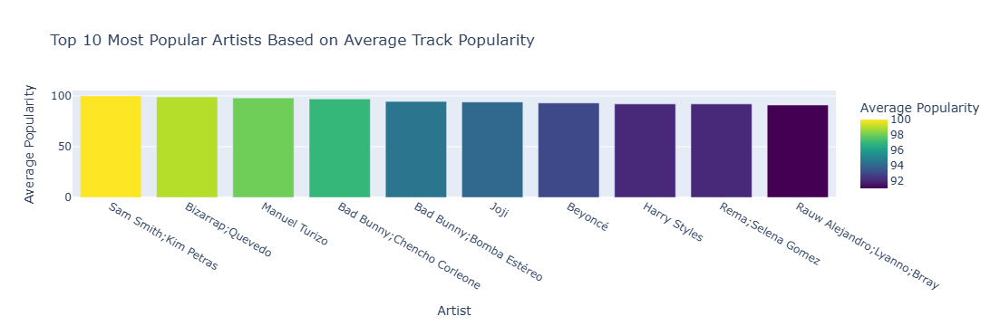

In [5]:
# Grouping by artist and calculating the average popularity for each artist
artist_popularity = df.groupby('artists')['popularity'].mean().reset_index()

# Sorting artists by average popularity in descending order
artist_popularity_sorted = artist_popularity.sort_values(by='popularity', ascending=False)

# top 10 most popular artists based on average track popularity
print(artist_popularity_sorted.head(10))

fig = px.bar(artist_popularity_sorted.head(10), 
             x='artists', 
             y='popularity', 
             title="Top 10 Most Popular Artists Based on Average Track Popularity",
             labels={'artists': 'Artist', 'popularity': 'Average Popularity'},
             color='popularity',
             color_continuous_scale='Viridis')



fig.show()

fig.write_html("popular_artist.html")

# Do more danceable songs tend to be more popular?

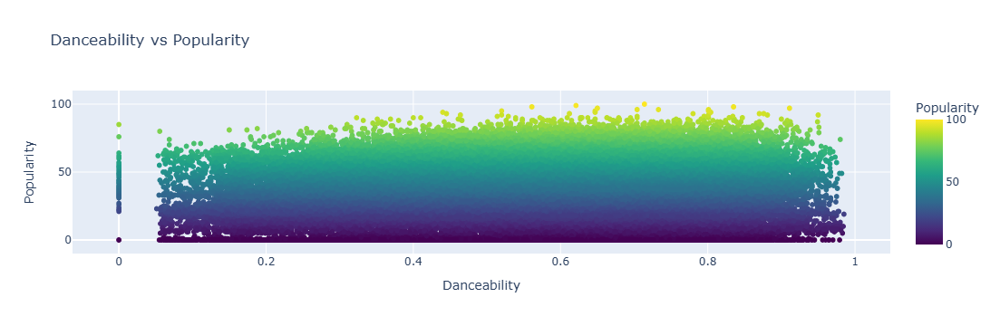

In [7]:
fig = px.scatter(df, 
                 x='danceability', 
                 y='popularity', 
                 title='Danceability vs Popularity',
                 labels={'danceability': 'Danceability', 'popularity': 'Popularity'},
                 color='popularity',
                 color_continuous_scale='Viridis',
                 hover_data=['artists', 'track_name'])  

fig.show()

fig.write_html("dance.html")

# Actual vs Predicted Song Popularity

Mean Squared Error: 488.75536132196424
R-squared: 0.009575900687447292


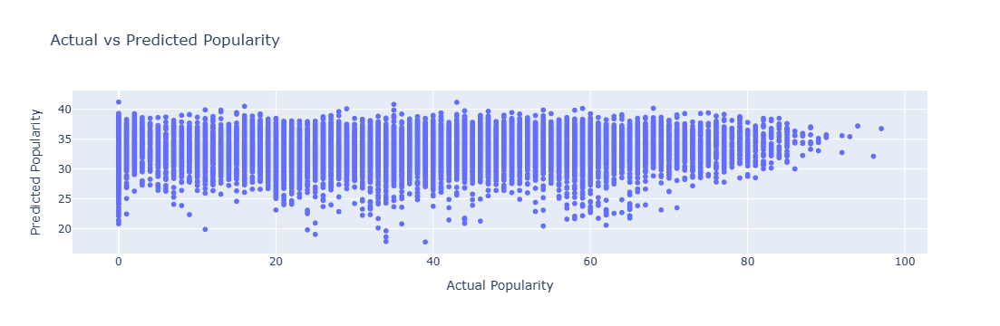

In [9]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler

# Data Preprocessing: Dropping rows with missing values (if any)
df = df.dropna(subset=['popularity', 'danceability', 'energy', 'valence', 'loudness', 'tempo'])

features = ['danceability', 'energy', 'valence', 'loudness', 'tempo']
target = 'popularity'

X = df[features]
y = df[target]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardizing the features 
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Linear Regression model
model = LinearRegression()
model.fit(X_train_scaled, y_train)

# Predict the popularity on the test data
y_pred = model.predict(X_test_scaled)

# Evaluate the model's performance
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# evaluation metrics
print(f"Mean Squared Error: {mse}")
print(f"R-squared: {r2}")

# Visualize the actual vs predicted popularity 
fig = px.scatter(x=y_test, y=y_pred, labels={'x': 'Actual Popularity', 'y': 'Predicted Popularity'},
                 title="Actual vs Predicted Popularity")
fig.show()

fig.write_html("actualvspredicted.html")

# Classification models to categorize songs into different genres

Accuracy: 17.01%

Classification Report:
                   precision    recall  f1-score   support

         acoustic       0.12      0.10      0.11       213
         afrobeat       0.10      0.08      0.09       203
         alt-rock       0.02      0.02      0.02       215
      alternative       0.12      0.14      0.13       184
          ambient       0.13      0.13      0.13       197
            anime       0.08      0.06      0.07       193
      black-metal       0.28      0.30      0.29       210
        bluegrass       0.17      0.20      0.18       205
            blues       0.12      0.11      0.11       214
           brazil       0.00      0.00      0.00       197
        breakbeat       0.16      0.13      0.14       199
          british       0.07      0.05      0.06       214
         cantopop       0.11      0.12      0.12       193
    chicago-house       0.28      0.35      0.31       206
         children       0.29      0.25      0.27       214
            ch

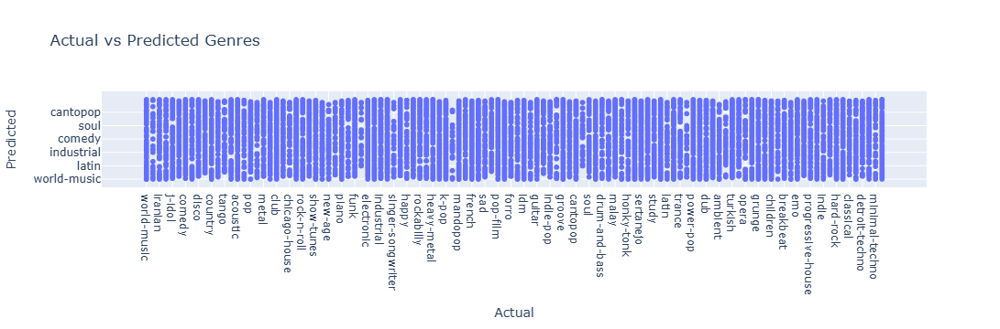

In [11]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score

# Dropping rows with missing values
df = df.dropna(subset=['track_genre', 'danceability', 'energy', 'valence', 'loudness', 'tempo'])

# Selecting relevant features and target
features = ['danceability', 'energy', 'valence', 'loudness', 'tempo']
target = 'track_genre'

X = df[features]
y = df[target]

# Split the data into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features 
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Build the Random Forest model 
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train_scaled, y_train)

# Predict the genres on the test data
y_pred = model.predict(X_test_scaled)

# Evaluate the model's performance
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy * 100:.2f}%")

# classification report
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# Visualize the actual vs predicted genres
df_results = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
fig = px.scatter(df_results, x='Actual', y='Predicted', title="Actual vs Predicted Genres")
fig.show()

fig.write_html("classification.html")

# Song recommendation system based on a track’s features

In [13]:
import faiss
import numpy as np

df = df.dropna(subset=['danceability', 'energy', 'valence', 'loudness', 'tempo'])

# Select features
features = ['danceability', 'energy', 'valence', 'loudness', 'tempo']
X = df[features].values  

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X).astype('float32')  # FAISS requires float32

# FAISS index
d = X_scaled.shape[1]  
index = faiss.IndexFlatL2(d)  
index.add(X_scaled)  

# Function to recommend songs based on a given song index
def recommend_song(song_idx, num_recommendations=5):
    distances, indices = index.search(X_scaled[song_idx:song_idx+1], num_recommendations+1)
    recommended_song_indices = indices[0][1:] 
    return df.iloc[recommended_song_indices][['album_name', 'artists', 'track_genre']]

# Example
recommended_songs = recommend_song(song_idx=2, num_recommendations=10)
print("Recommended Songs:")
print(recommended_songs)

fig.write_html("recommendation.html")

Recommended Songs:
                              album_name                        artists  \
12789          我愛經典系列 - 陳百強 (Danny Chan)  Danny Chan;Joe Wong;Tom Brown   
4014                           Affection           Cigarettes After Sex   
56468                          Affection           Cigarettes After Sex   
57808                          Affection           Cigarettes After Sex   
70222                              愛我的時候                  Eric Chou;單依純   
113535                    Simply Worship               Hillsong Worship   
112274             Gökyüzümün Yıldızları                     Cem Adrian   
63593                Gökyüzü Herkesindir                 Zülfü Livaneli   
70855                          愛是我們必經的辛苦                 Crispy脆樂團;恐龍的皮   
113365  Living Hope (The House Sessions)                   Phil Wickham   

        track_genre  
12789      cantopop  
4014        ambient  
56468     indie-pop  
57808         indie  
70222      mandopop  
113535  world-music  
1